# Wisconsin Breast Cancer Exploratory Data Analysis

<hr>

## Prepared by Ikram El-hajri <br>

##### 10/05/2024
![img](img.jpg)

<a id='toc'></a>
# Table of Content

* [Introduction](#intro)
* [Importing packages and loading data](#pac)
* [Data cleaning and data wrangling](#clean)
* [Exploratory Data Analysis (EDA)](#eda)
    * [Basic Statistical Details](#bsd)
    * [Violin plot of features by diagnosis](#vpf)
    * [Kde Plot For Each Mean Feature](#kde)
    * [Relationship Between Features](#rbf)
        * [Correlation Heatmap](#chm)
        * [Feature Pair](#fp)
        * [Positively Correlated Features](#pcf)
        * [Un-Correlated Features](#ucf)
        * [Negatively Correlated Features](#ncf)
* [Statistical Analysis(Outliers)](#sa)
    * [Box Plot](#bp)
    * [Remove Outliers Using IQR](#iqr)
* [Principal Component Analysis(PCA)](#pca)
* [t-SNE (t-distributed Stochastic Neighbor Embedding)](#tsne)
* [Machine Learning Classification](#ml)
    * [Building Feature Set](#sp)
    * [Support Vector Machine (SVM)](#svm)
        * [Kernel Selection Using Learning Curve ](#ks)
        * [Selection of Regularization parameter(C)](#srp)
        * [Confusion Metrix and ROC Curve](#cmrc)
* [Summary of models performance](#sum)

<a id='intro'></a>
## Introduction<br>

In this notebook,I will conduct an EDA on a breast cancer dataset. The primary goal is to gain insights into the data distribution, identify patterns, and explore potential relationships between various features.

The Breast Cancer (Wisconsin) Diagnosis dataset contains the diagnosis and a set of 30 features describing the characteristics of the cell nuclei present in the digitized image of a of a fine needle aspirate (FNA) of a breast mass.
<br><br>

Attribute Information:

- 1) ID number

- 2) Diagnosis (M = malignant, B = benign)
Ten real-valued features are computed for each cell nucleus:

- radius (mean of distances from center to points on the perimeter);
- texture (standard deviation of gray-scale values);
- perimeter;
- area;
- smoothness (local variation in radius lengths);
- compactness (perimeter^2 / area - 1.0);
- concavity (severity of concave portions of the contour);
- concave points (number of concave portions of the contour);
- symmetry;
- fractal dimension (“coastline approximation” - 1).

<br><br>
The mean, standard error (SE) and “worst” or largest (mean of the three largest values) of these features were computed for each image, resulting in 30 features.
<br><br>
We will analyze the features to understand the predictive value for diagnosis.

<a id='pac'></a>
## Importing Packages and Loading Data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.model_selection import train_test_split,ShuffleSplit
import warnings
from sklearn.metrics import classification_report


# Ignore warnings

import warnings
warnings.filterwarnings("ignore")

#import visuals.py 
import visuals as vp
import properties_1 as ps
sns.set_style('whitegrid')
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from itertools import chain

from plotly import tools
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.offline as py
from plotly.graph_objs import Scatter, Layout
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.figure_factory as ff

from collections import Counter
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.metrics import precision_score, recall_score, confusion_matrix, precision_recall_fscore_support
from sklearn.metrics import roc_auc_score,auc,f1_score
from sklearn.metrics import precision_recall_curve,roc_curve
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
import seaborn as sns

<a id='data'></a>
### Load the Data

In [2]:
# Set your Kaggle API credentials (API key)
os.environ['KAGGLE_USERNAME'] = 'ikramelhajri'
os.environ['KAGGLE_KEY'] = '414da186fbf2686d7e14360783904118'

In [3]:
# Specify the dataset details
dataset_slug = "uciml/breast-cancer-wisconsin-data"
dataset_path = "/data/breast_cancer_data"

In [4]:
# Download the dataset using Kaggle API
!kaggle datasets download -d {dataset_slug} -p {dataset_path} --unzip

print("Dataset downloaded at:", dataset_path)

Dataset URL: https://www.kaggle.com/datasets/uciml/breast-cancer-wisconsin-data
License(s): CC-BY-NC-SA-4.0

Dataset downloaded at: /data/breast_cancer_data



  0%|          | 0.00/48.6k [00:00<?, ?B/s]
100%|##########| 48.6k/48.6k [00:00<00:00, 835kB/s]


In [20]:
csv_file_path = "/data/wisc_bc_data/wisc_bc_data.csv"
df = pd.read_csv(csv_file_path)

## Data Exploration

In [6]:
df.T.head()

,0,1,2,3,4,5,6,7,8,9,...,559,560,561,562,563,564,565,566,567,568
id,87139402,8910251,905520,868871,9012568,906539,925291,87880,862989,89827,...,9110944,854268,89511501,9113156,894855,911320502,898677,873885,911201,9012795
diagnosis,B,B,B,B,B,B,B,M,B,B,...,B,M,B,B,B,B,B,M,B,M
radius_mean,12.32,10.6,11.04,11.28,15.19,11.57,11.51,13.81,10.49,11.06,...,14.8,14.25,12.2,14.4,12.86,13.17,10.26,15.28,14.53,21.37
texture_mean,12.39,18.95,16.83,13.39,13.21,19.04,23.93,23.75,19.29,14.96,...,17.66,21.72,15.21,26.99,13.32,18.22,14.71,22.41,13.98,15.1
perimeter_mean,78.85,69.28,70.92,73.0,97.65,74.2,74.52,91.56,67.41,71.49,...,95.88,93.63,78.01,92.25,82.82,84.28,66.2,98.92,93.86,141.3


In the context of medical diagnoses, particularly in relation to tumors, **'benign'** is the term that refers to a condition that is not harmful in effect. In other words, a benign tumor is not cancerous and does not spread to other parts of the body.

On the other hand, **'malignant'** is the term used to describe a severe and progressively worsening disease. Specifically, a malignant tumor is cancerous, capable of spreading to other parts of the body, and can be life-threatening.

![image](image.png)


- 0 --> Malignant (cancerous/ unhealthy condition).
- 1 --> Benign (not cancerous/healthy condition).

<a id='clean'></a>
## Data cleaning and data wrangling

#### Check for null and missing values

In [7]:
null_values = df.isnull().values.any()
if null_values == True:
    print("There are some missing values in data")
else:
    print("There are no missing values in the dataset")

There are no missing values in the dataset


The dataset contains no null or missing values.

#### Check for duplicate elements

In [8]:
sum(df.duplicated())

0

#### Deleting useless columns

In [9]:
#deleting the "id" column
df.drop("id",axis=1,inplace=True)

In [10]:
print("Total data points",df.shape[0])
print("Total number of features(as number of columns) are ", 
df.shape[1])

Total data points 569
Total number of features(as number of columns) are  31


The dataframe consists of 569 entries and 32 columns, with no missing values. The columns include various features related to tumor characteristics, such as radius, texture, perimeter, area, smoothness, compactness, concavity, points, symmetry, and dimension.

### Display descriptive statistics of the dataframe

The descriptive statistics provide insights into the distribution of numerical features in the dataset, including count, mean, standard deviation, minimum, 25th percentile, median (50th percentile), 75th percentile, and maximum values.

<a id='eda'></a>
# Exploratory Data Analysis (EDA)

The Exploratory Data Analysis (EDA) section aims to gain insights into the Breast Cancer Wisconsin dataset through visualizations.

- **Count:** The number of non-null values in each col = the size of the dataset.
- **Mean:** The avg val for each feature.
- **Std:** The standard deviation, a measure of the amount of variation or dispersion of a set of values.
- **Min:** The minimum value observed in each feature.
- **25%:** The 25th percentile, also known as the first quartile.
- **50% (median):** The median or 50th percentile, which represents the middle value of the dataset.
- **75%:** The 75th percentile, also known as the third quartile.
- **Max:** The maximum value observed in each feature.

<a id='bsd'></a>
## Basic Statistical Details

In [11]:
df.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,points_mean,symmetry_mean,dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,points_worst,symmetry_worst,dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


### Transpose descriptive statistics for better readability


The transposed descriptive statistics provide a clearer view of the statistical summary for each feature.

In [12]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
radius_mean,569.0,14.127292,3.524049,6.981000,11.700000,13.370000,15.780000,28.11000
texture_mean,569.0,19.289649,4.301036,9.710000,16.170000,18.840000,21.800000,39.28000
perimeter_mean,569.0,91.969033,24.298981,43.790000,75.170000,86.240000,104.100000,188.50000
area_mean,569.0,654.889104,351.914129,143.500000,420.300000,551.100000,782.700000,2501.00000
smoothness_mean,569.0,0.096360,0.014064,0.052630,0.086370,0.095870,0.105300,0.16340
compactness_mean,569.0,0.104341,0.052813,0.019380,0.064920,0.092630,0.130400,0.34540
concavity_mean,569.0,0.088799,0.079720,0.000000,0.029560,0.061540,0.130700,0.42680
points_mean,569.0,0.048919,0.038803,0.000000,0.020310,0.033500,0.074000,0.20120
symmetry_mean,569.0,0.181162,0.027414,0.106000,0.161900,0.179200,0.195700,0.30400
dimension_mean,569.0,0.062798,0.007060,0.049960,0.057700,0.061540,0.066120,0.09744


In [13]:
p = df.describe().T
p = p.round(4)
table = go.Table(
    columnwidth=[0.8]+[0.5]*8,
    header=dict(
        values=['Attribute'] + list(p.columns),
        line = dict(color='#506784'),
        fill = dict(color='lightblue'),
    ),
    cells=dict(
        values=[p.index] + [p[k].tolist() for k in p.columns[:]],
        line = dict(color='#506784'),
        fill = dict(color=['rgb(173, 216, 220)', '#f5f5fa'])
    )
)
py.iplot([table], filename='table-of-mining-data')

#### Split the dataframe into three parts based on feature groups


In [14]:
df_mean = df[df.columns[:11]]
df_se = df.drop(df.columns[1:11], axis=1)
df_se = df_se.drop(df_se.columns[11:], axis=1)
df_worst = df.drop(df.columns[1:21], axis=1)

In [15]:
print(df_mean)

    diagnosis  radius_mean  texture_mean  perimeter_mean  area_mean  \
0           B        12.32         12.39           78.85      464.1   
1           B        10.60         18.95           69.28      346.4   
2           B        11.04         16.83           70.92      373.2   
3           B        11.28         13.39           73.00      384.8   
4           B        15.19         13.21           97.65      711.8   
..        ...          ...           ...             ...        ...   
564         B        13.17         18.22           84.28      537.3   
565         B        10.26         14.71           66.20      321.6   
566         M        15.28         22.41           98.92      710.6   
567         B        14.53         13.98           93.86      644.2   
568         M        21.37         15.10          141.30     1386.0   

     smoothness_mean  compactness_mean  concavity_mean  points_mean  \
0            0.10280           0.06981         0.03987      0.03700   
1    

#### Extract the target variable 'diagnosis'



In [16]:
y = df.diagnosis
B, M = y.value_counts()
print( 'Number of Benign Tumors ', B)
print( 'Number of Malignant Tumors ', M)

Number of Benign Tumors  357
Number of Malignant Tumors  212


#### Display the unique number of data values for each column

In [17]:
print("The unique number of data values are")
df.nunique()

The unique number of data values are


diagnosis              2
radius_mean          456
texture_mean         479
perimeter_mean       522
area_mean            539
smoothness_mean      474
compactness_mean     537
concavity_mean       537
points_mean          542
symmetry_mean        432
dimension_mean       499
radius_se            540
texture_se           519
perimeter_se         533
area_se              528
smoothness_se        547
compactness_se       541
concavity_se         533
points_se            507
symmetry_se          498
dimension_se         545
radius_worst         457
texture_worst        511
perimeter_worst      514
area_worst           544
smoothness_worst     411
compactness_worst    529
concavity_worst      539
points_worst         492
symmetry_worst       500
dimension_worst      535
dtype: int64

## Visualizations

Now let's plot the numerical data to see the distributions:

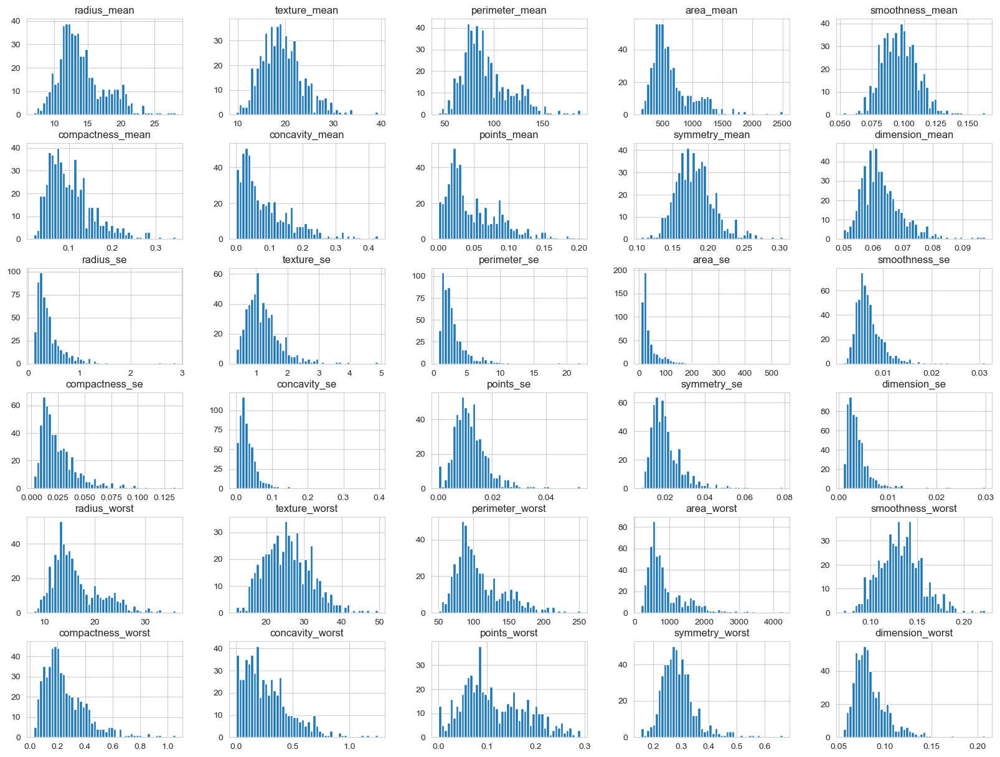

In [19]:
X = df.drop(['diagnosis'], axis=1)
X.hist(bins=50, figsize=(20,15))
plt.show()

## Diagnoses Distribution

### Number of Diagnoses in Two Groups

**Description:**
In this plot, we visualize the distribution of diagnoses in two groups: benign (B) and malignant (M).

In [20]:
import plotly.graph_objects as go

# Get value counts of diagnosis
cnt_pro = df['diagnosis'].value_counts()

# Define colors and labels
colors = ['#981c6c', '#fc5c94']  # Adjusted colors
labels = ['Malignant', 'Benign']

# Create a bar plot
fig = go.Figure()

# Add trace for each category
for label, color, count in zip(labels, colors, cnt_pro.values):
    fig.add_trace(go.Bar(
        x=[label],
        y=[count],
        name=label,
        marker=dict(color=color),
    ))

# Update layout
fig.update_layout(
    title='Diagnosis Distribution',
    xaxis=dict(title='Diagnosis'),
    yaxis=dict(title='Number of Diagnosis'),
    showlegend=True,
)

# Show the plot
fig.show()


In [6]:
import plotly.graph_objs as go
import plotly.offline as py

B, M = df['diagnosis'].value_counts()

# Bar chart
trace1 = go.Bar(
    y=[M, B],
    x=['malignant', 'benign'],
    opacity=0.8,
    marker=dict(color='#981c6c')  # Set the color for the Bar chart
)

# Pie chart
trace2 = go.Pie(
    labels=['Benign', 'Malignant'],
    values=df['diagnosis'].value_counts(),
    textfont=dict(size=15),
    opacity=0.8,
    marker=dict(colors=['#fc5c94', '#981c6c'])  # Set the colors for the Pie chart
)

# Plot the Pie chart
py.iplot([trace2])


This graph is likely used to visualize the distribution of diagnoses in the dataset, **with a larger number of benign cases compared to malignant ones**. It’s a common way to understand the balance of classes in a dataset before applying machine learning techniques.

<a id='vpf'></a>
> ### Violin Plot of Features by Diagnosis

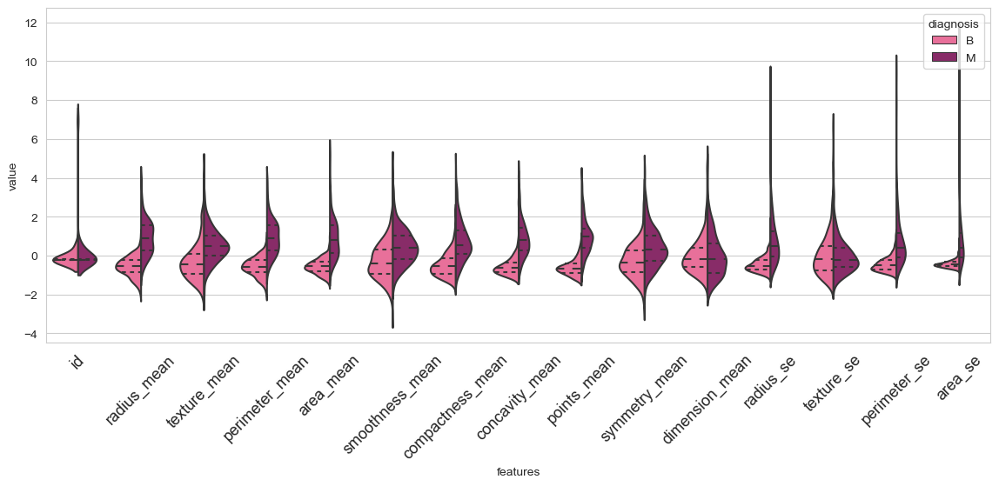

In [7]:
data_dia = df['diagnosis']
data = df.drop('diagnosis', axis=1)
data_n_2 = (data - data.mean()) / (data.std())  # standardization
data = pd.concat([df['diagnosis'], data_n_2.iloc[:, 0:15]], axis=1)
data = pd.melt(data, id_vars="diagnosis",
               var_name="features",
               value_name='value')

custom_palette = {'M': "#981c6c", 'B': "#fc5c94"}

plt.figure(figsize=(14, 5))
sns.violinplot(x="features", y="value", hue="diagnosis", data=data, split=True, inner="quart", palette=custom_palette)
plt.xticks(rotation=45, fontsize=13)
plt.show()


> Interpretion of the plot above:
  In **texture_mean** feature, median of the Malignant and Benign looks like separated so it can be good for classification. However, in **dimension_mean** feature, median of the Malignant and Benign does not looks like separated so it does not gives good information for classification

<a id='kde'></a>
> ### Kde Plot For Each Mean Feature 

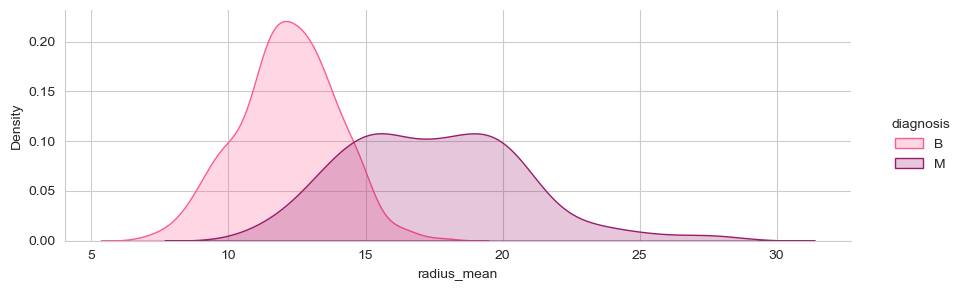

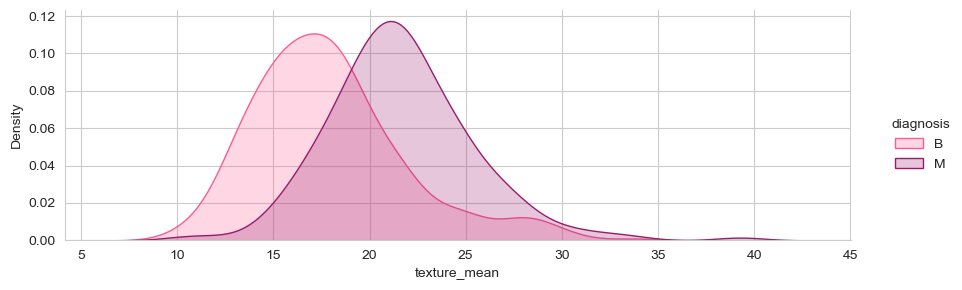

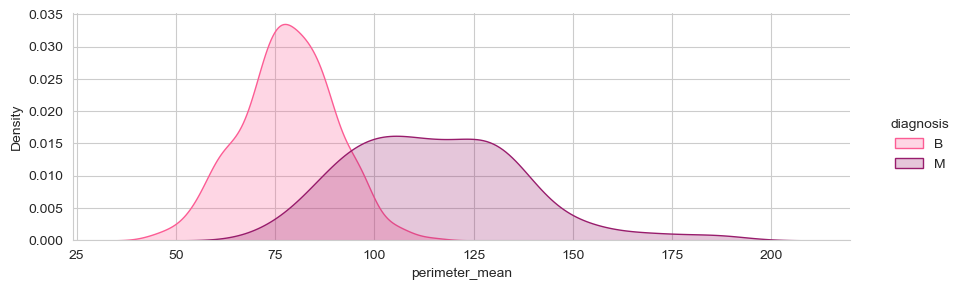

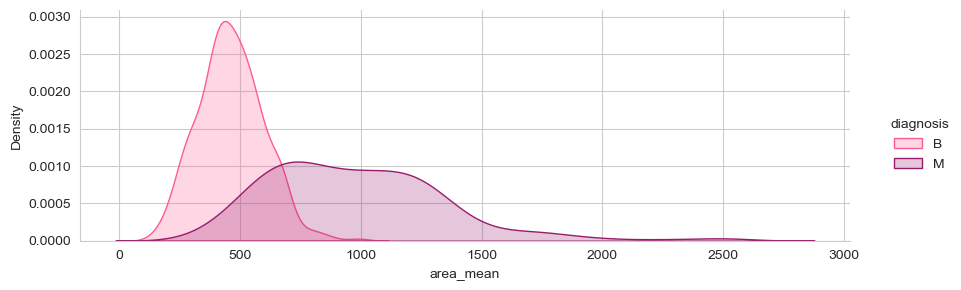

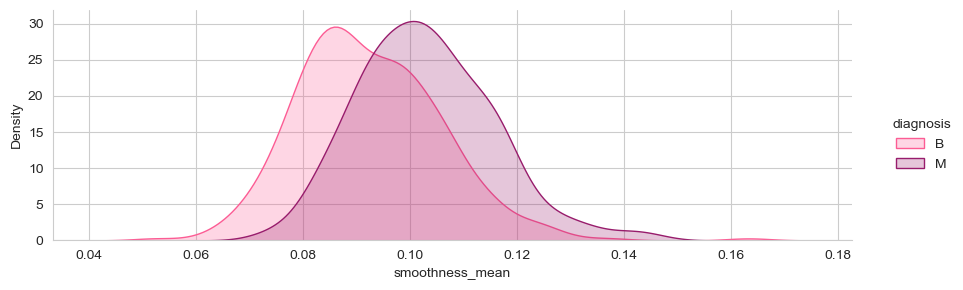

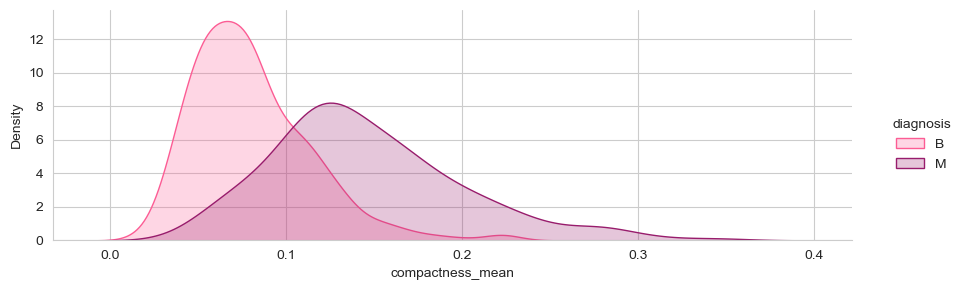

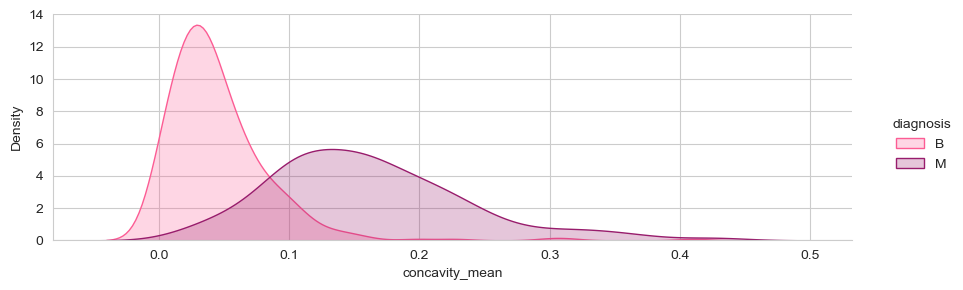

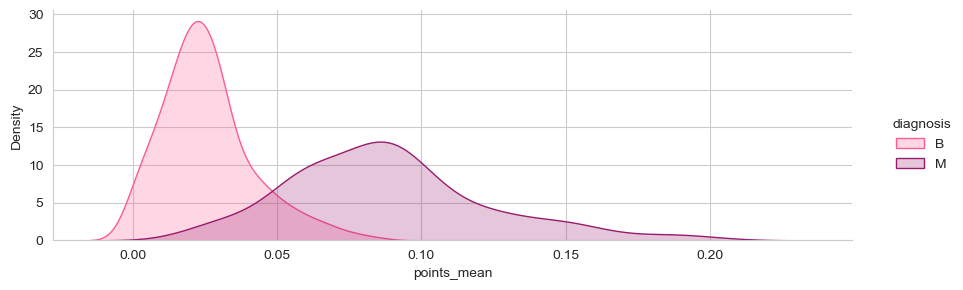

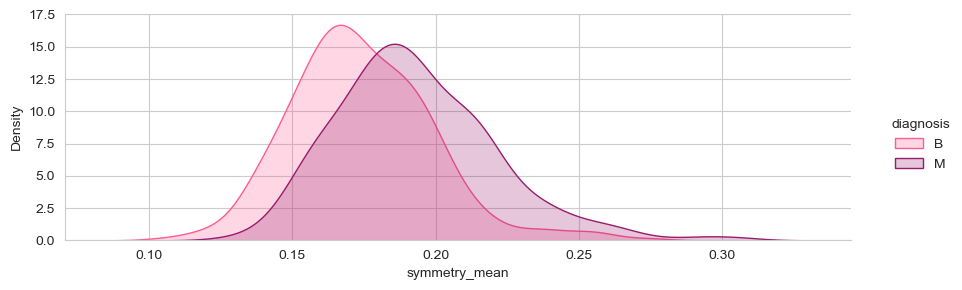

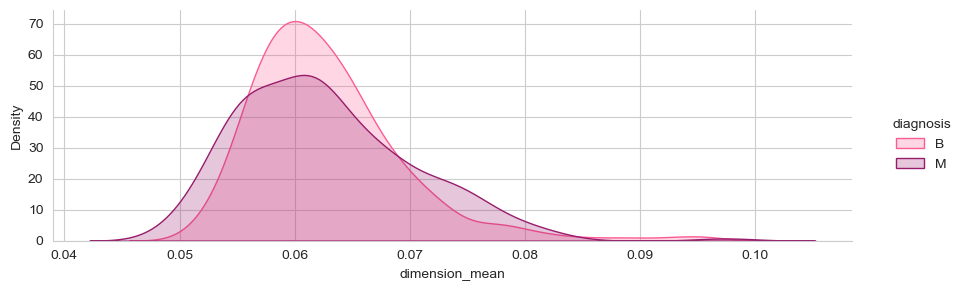

In [8]:
mean_col = [col for col in df.columns if col.endswith('_mean')]

# Define custom colors
custom_palette = {'M': "#981c6c", 'B': "#fc5c94"}

for i in range(len(mean_col)):
    g = sns.FacetGrid(df, hue="diagnosis", aspect=3, margin_titles=True, palette=custom_palette)
    g.map(sns.kdeplot, mean_col[i], shade=True)
    g.add_legend()

plt.show()

<a id='rbf'></a>
## Relationship Between Features  <br>

- Lets look at relationship between radius mean and area mean. In scatter plot you can see that when radius mean increases, area mean also increases. Therefore, they are positively correlated with each other.
- There is no correlation between area mean and dimension se. Because when area mean changes, dimension se is not affected by chance of area mean

<a id='chm'></a>
> ### Correlation Heatmap

This heatmap is used to understand the rs between different features and the target in the dataset, which can be crucial for feature selection in ML models.

- The heatmap is organized in a grid format where both rows and columns are labeled with feature names like "mean radius," "mean texture," "mean perimeter," etc.
- The color intensity and the numerical value within each cell represent the strength and direction of the correlation; darker red indicates stronger positive correlations, while darker purple indicates stronger negative correlations.
- There is a color scale on the right side of the heatmap ranging from -1 to 1 to help interpret the colors' meaning; -1 indicates perfect negative correlation, 0 no correlation, and 1 perfect positive correlation.
- Some cells have stronger correlations as indicated by their intense color (either red or purple) and are particularly important for understanding relationships among variables.

In [22]:
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Generate a correlation matrix
corr_matrix = df.corr()

# Create a heatmap
fig = go.Figure(data=go.Heatmap(
    z=corr_matrix.values,
    x=corr_matrix.columns,
    y=corr_matrix.columns,
    colorscale='RdBu',
    zmin=-1,
    zmax=1,
    colorbar=dict(title='Correlation'),
))

# Update layout
fig.update_layout(
    title='Correlation Heatmap',
    xaxis=dict(title='Features'),
    yaxis=dict(title='Features'),
)

# Show the plot
fig.show()


### Diagonal Correlation Matrix for quick viewing

> **observation:**  <br> In a correlation heat map, the way its interpreted is higher the correlation value, the more correlated the two variables(features) are:

1. **Radius**, Area and Perimeter are correlated (corr>0.9) which is obvious as area and perimeter is calculated using the radius values.
2. **Texture_mean** and texture_worst are higly correlated with corr_value = 0.98 (texture_worst is the largest value of all the textures).
3. **Compactness_mean**,concavity_mean,concave_points_mean are also highy correlated with values in range 0.7 to 0.9.
4. **Symmetry_mean** and symmetry_worst are correlated too by values 0.7.
5. **dimension_mean** and dimension_worst are correlated by value 0.77

> **Conclusion** <br> - The radius, parameter and area are **highly correlated** as expected from their relation so from these we will use anyone of them <br> - compactness_mean, concavity_mean and concavepoint_mean are **highly correlated** so we will use compactness_mean from here<br>  - so selected Parameter for use is **perimeter_mean**, **texture_mean**, **compactness_mean**, **symmetry_mean**

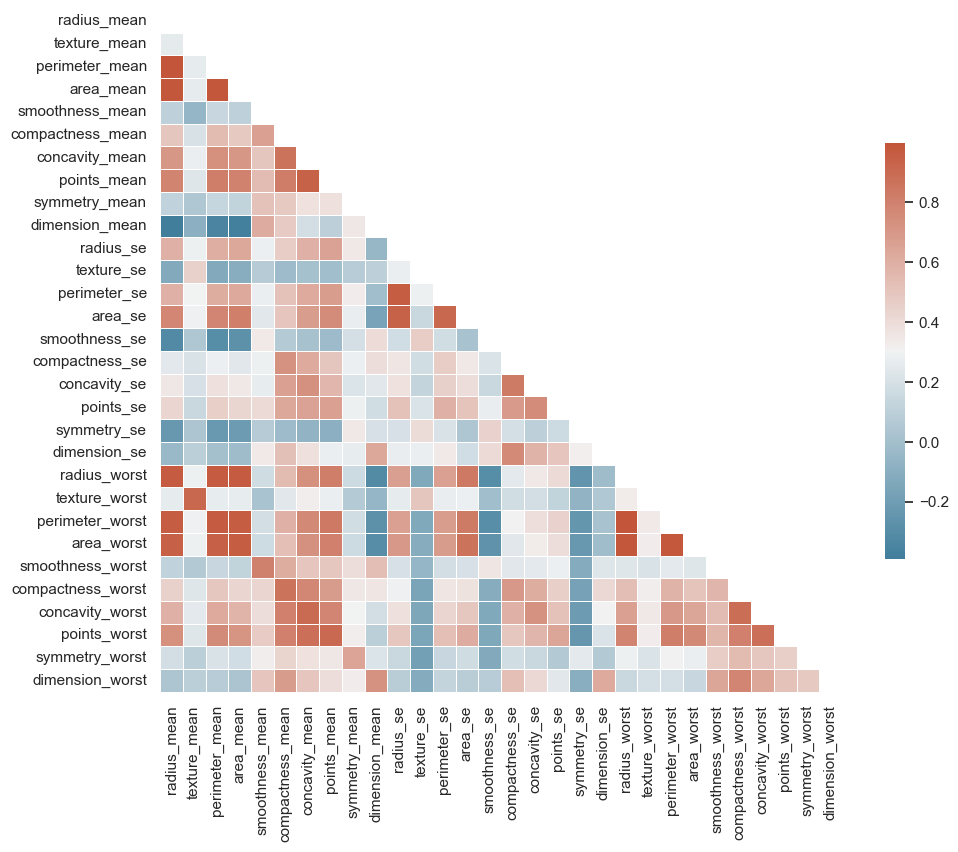

In [45]:
sns.set_theme(style="white")
corr = df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, square=True, linewidths=.5, cbar_kws={"shrink": .6})
plt.show()

Lets analyze these features in more depth by looking at distribution plots of each of these features. We could look at them in the same grouped order to keep our thoughts in flow.

<a id='fp'></a>
> ### Feature Pair

In [24]:
sns.pairplot(df, hue = "diagnosis", diag_kind='kde')
plt.show()

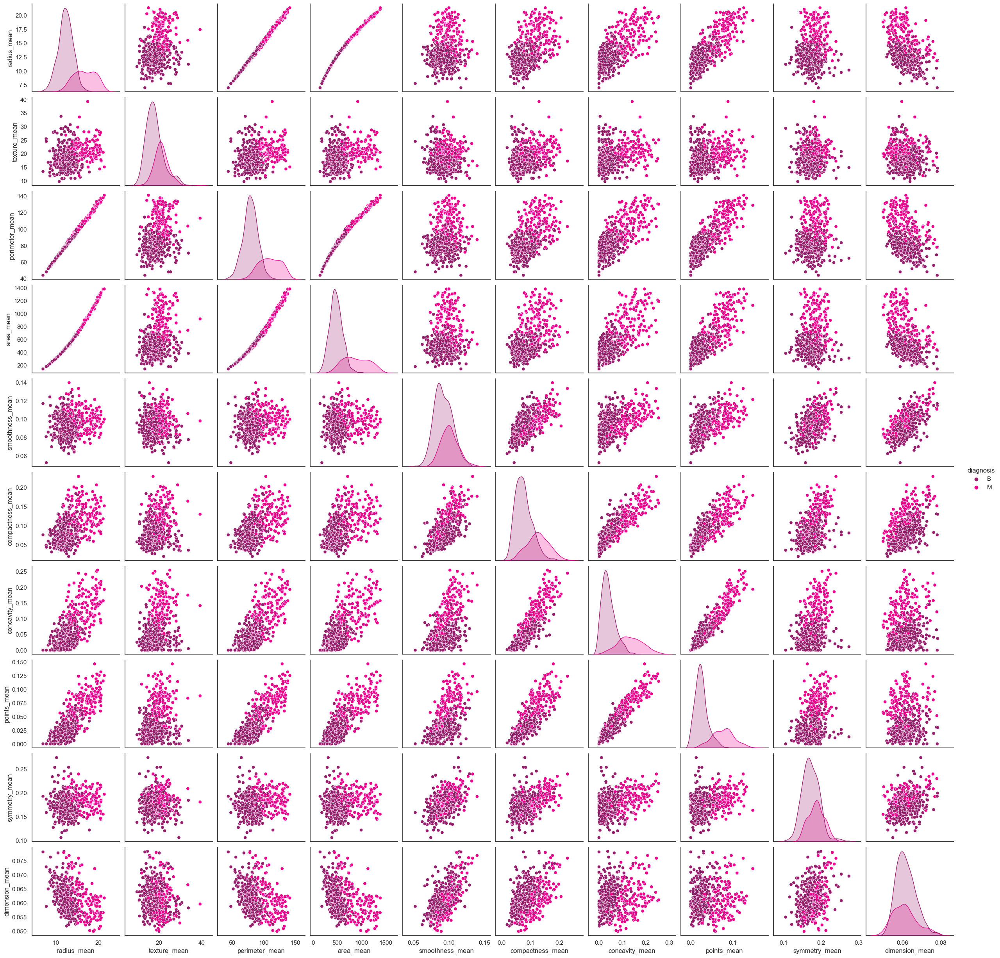

In [47]:
import seaborn as sns
import pandas as pd

# Define the columns for mean values
columns_mean = ('diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean', 'points_mean', 'symmetry_mean', 'dimension_mean')

# Create a DataFrame with the selected columns
df_mean = pd.DataFrame(df, columns=columns_mean)

# Plot pair plots
sns.pairplot(df_mean, hue="diagnosis", diag_kind='kde', palette=["#981c6c", "#ed008c"])

# Show the plot
plt.show()


<a id='pcf'></a>
> ### Positively Correlated Features

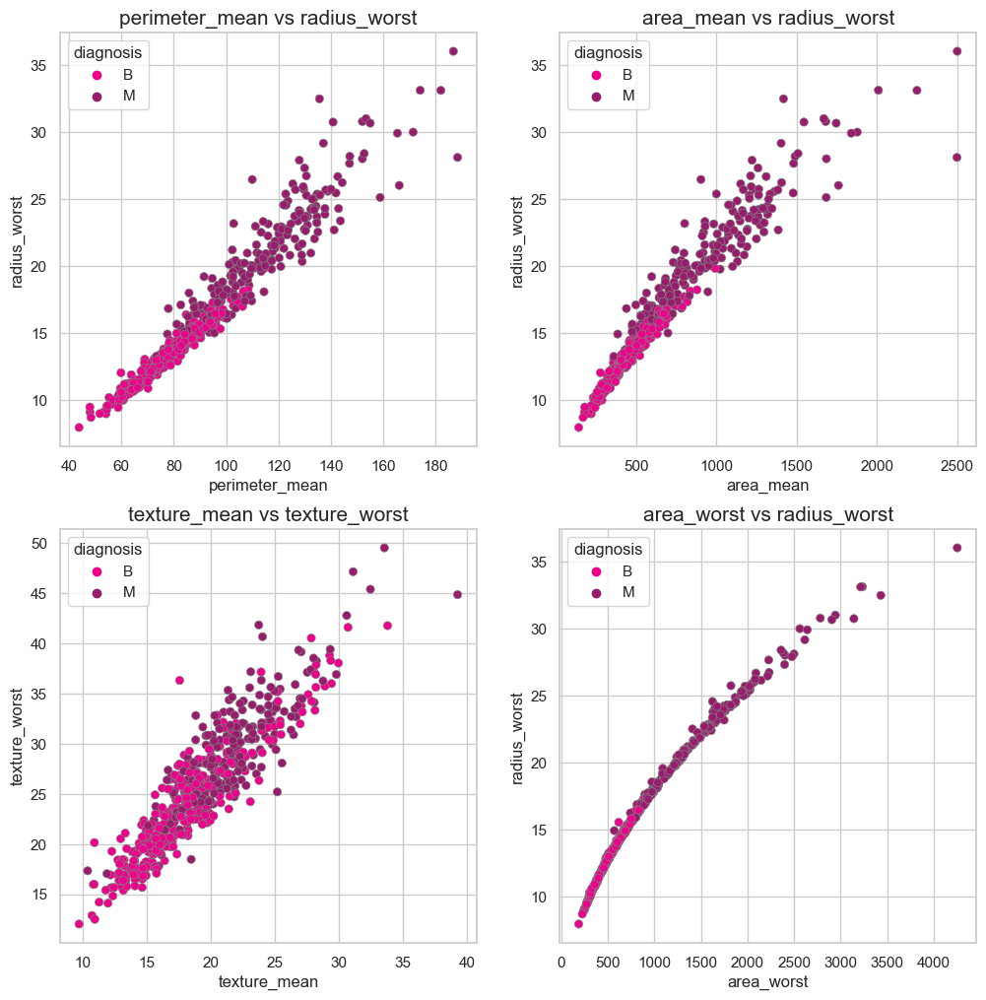

In [26]:
palette = ['#ed008c', '#981c6c']
edgecolor = 'grey'

# Plot +
fig = plt.figure(figsize=(12,12))
sns.set_style('whitegrid')
sns.color_palette("bright")

def plot_scatter(a, b, k):
    plt.subplot(k)
    sns.scatterplot(x=df[a], y=df[b], hue="diagnosis",
                    data=df, palette=palette, edgecolor=edgecolor)
    plt.title(a + ' vs ' + b, fontsize=15)
    k += 1

plot_scatter('perimeter_mean', 'radius_worst', 221)   
plot_scatter('area_mean', 'radius_worst', 222)   
plot_scatter('texture_mean', 'texture_worst', 223)   
plot_scatter('area_worst', 'radius_worst', 224) 


<a id = 'ucf'></a>
> ### Un-Correlated Features 

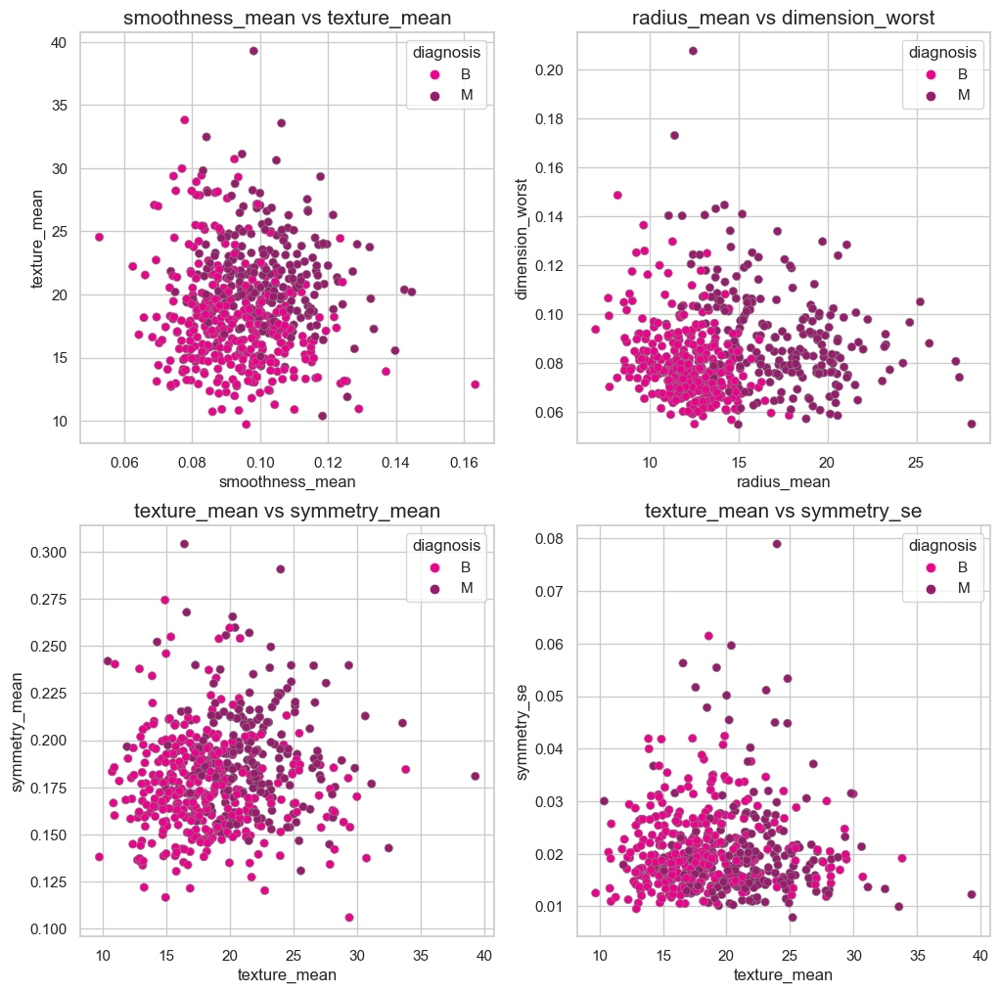

In [28]:
fig = plt.figure(figsize=(12,12))
plot_scatter('smoothness_mean','texture_mean',221)
plot_scatter('radius_mean','dimension_worst',222)
plot_scatter('texture_mean','symmetry_mean',223)
plot_scatter('texture_mean','symmetry_se',224)

<a id='ncf'></a>
> ### Negatively Correlated Features

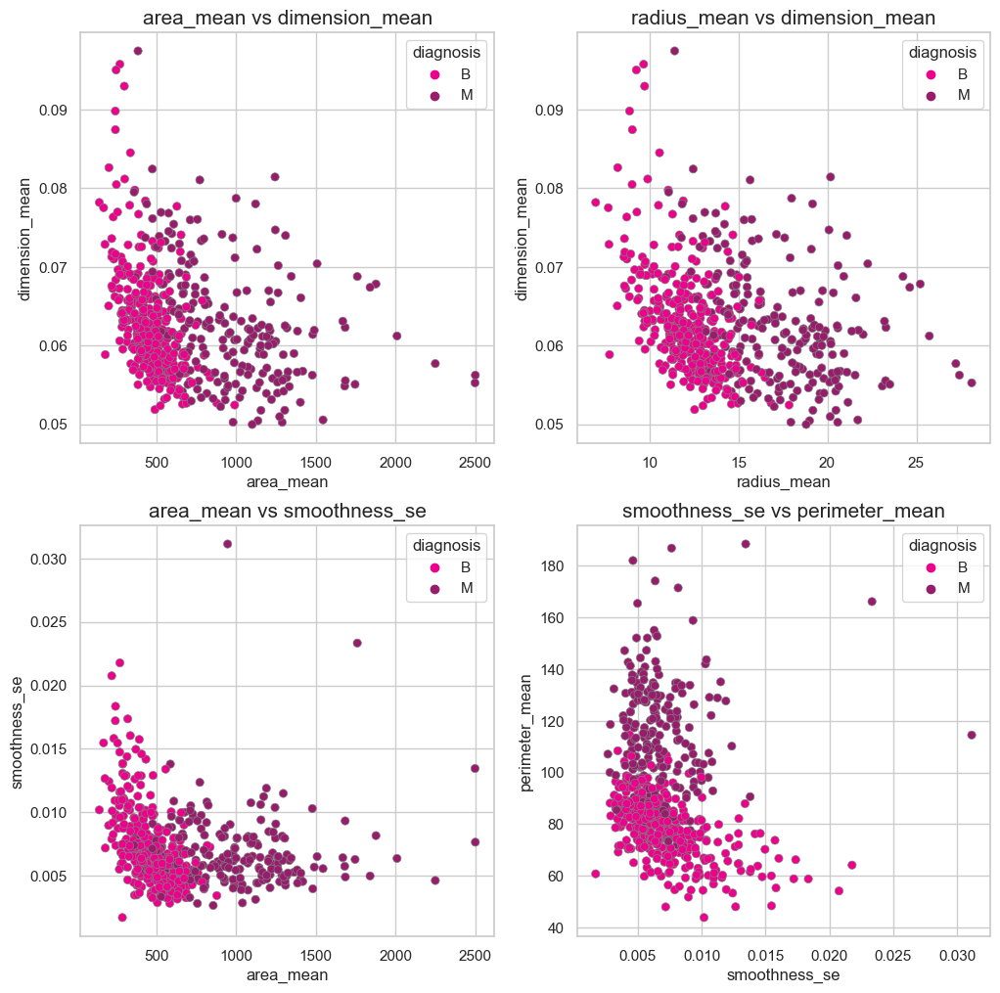

In [29]:
fig = plt.figure(figsize=(12,12))
plot_scatter('area_mean','dimension_mean',221)
plot_scatter('radius_mean','dimension_mean',222)
plot_scatter('area_mean','smoothness_se',223)
plot_scatter('smoothness_se','perimeter_mean',224)

<a id='sa'></a>

## Statistical Analysis(Outliers Detection) <br>


<a id='bp'></a>
> ### Box Plot

- first we need to calculate first quartile (Q1)(25%)
- then find IQR(inter quartile range) = Q3-Q1
- finally compute Q1 - 1.5IQR and Q3 + 1.5IQR
- Anything outside this range is an outlier

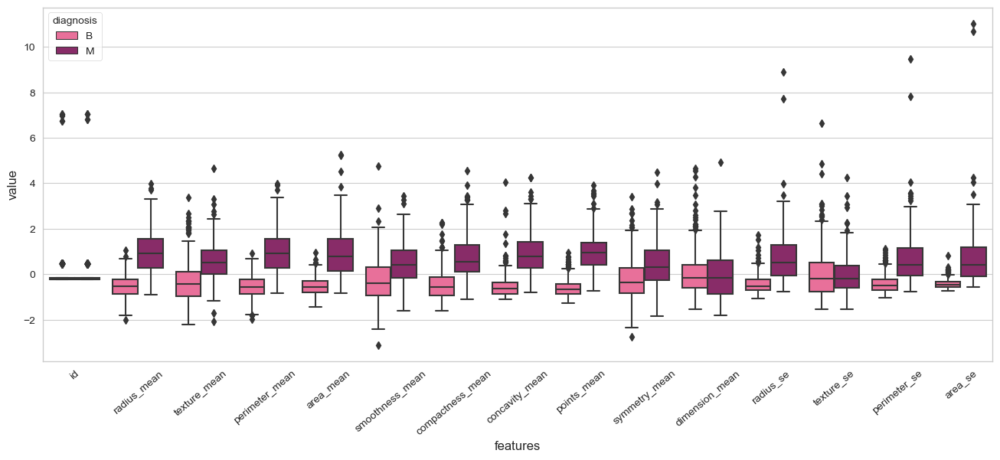

In [9]:
plt.style.use('ggplot')
sns.set_style('whitegrid')

custom_palette = {'M': "#981c6c", 'B': "#fc5c94"}

plt.figure(figsize=(16, 6))
sns.boxplot(x="features", y="value", hue="diagnosis", data=data, palette=custom_palette)
plt.xticks(rotation=40)
plt.show()


<a id='iqr'></a>
> ### Remove Outliers Using IQR

In [31]:
def detect_outliers(train_data,n,features):
    outlier_indices = []
    for col in features:
        # 1st quartile (25%)
        Q1 = np.percentile(train_data[col], 25)
        # 3rd quartile (75%)
        Q3 = np.percentile(train_data[col],75)
        # Interquartile range (IQR)
        IQR = Q3 - Q1
        outlier_step = 1.5 * IQR
        outlier_list_col = train_data[(train_data[col] < Q1 - outlier_step) | (train_data[col] > Q3 + outlier_step )].index
        outlier_indices.extend(outlier_list_col)
        
    outlier_indices = Counter(outlier_indices)        
    multiple_outliers = list( k for k, v in outlier_indices.items() if v > n )
    
    return multiple_outliers   

# detect outliers
list_atributes = df.drop('diagnosis',axis=1).columns
Outliers_to_drop = detect_outliers(df,2,list_atributes)

In [32]:
df.loc[Outliers_to_drop]

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,points_worst,symmetry_worst,dimension_worst
47,M,25.73,17.46,174.20,2010.0,0.11490,0.2363,0.3368,0.19130,0.1956,...,33.13,23.58,229.30,3234.0,0.1530,0.5937,0.6451,0.2756,0.3690,0.08815
54,M,23.29,26.67,158.90,1685.0,0.11410,0.2084,0.3523,0.16200,0.2200,...,25.12,32.68,177.00,1986.0,0.1536,0.4167,0.7892,0.2733,0.3198,0.08762
58,M,24.25,20.20,166.20,1761.0,0.14470,0.2867,0.4268,0.20120,0.2655,...,26.02,23.99,180.90,2073.0,0.1696,0.4244,0.5803,0.2248,0.3222,0.08009
99,M,25.22,24.91,171.50,1878.0,0.10630,0.2665,0.3339,0.18450,0.1829,...,30.00,33.62,211.70,2562.0,0.1573,0.6076,0.6476,0.2867,0.2355,0.10510
164,M,23.09,19.83,152.10,1682.0,0.09342,0.1275,0.1676,0.10030,0.1505,...,30.79,23.87,211.50,2782.0,0.1199,0.3625,0.3794,0.2264,0.2908,0.07277
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320,B,12.45,16.41,82.85,476.7,0.09514,0.1511,0.1544,0.04846,0.2082,...,13.78,21.03,97.82,580.6,0.1175,0.4061,0.4896,0.1342,0.3231,0.10340
404,B,13.24,20.13,86.87,542.9,0.08284,0.1223,0.1010,0.02833,0.1601,...,15.44,25.50,115.00,733.5,0.1201,0.5646,0.6556,0.1357,0.2845,0.12490
343,B,11.30,18.19,73.93,389.4,0.09592,0.1325,0.1548,0.02854,0.2054,...,12.58,27.96,87.16,472.9,0.1347,0.4848,0.7436,0.1218,0.3308,0.12970
144,M,14.58,21.53,97.41,644.8,0.10540,0.1868,0.1425,0.08783,0.2252,...,17.62,33.21,122.40,896.9,0.1525,0.6643,0.5539,0.2701,0.4264,0.12750


In [33]:
# Drop outliers
df = df.drop(Outliers_to_drop, axis = 0).reset_index(drop=True)

In [113]:
df.shape

(569, 32)

<a id='pca'></a>
## Principal Component Analysis(PCA)

This PCA projection helps visualize high-dimensional data in a lower-dimensional space, aiding in understanding data variance and patterns.

pupose :reduce the number of variables of a data set, while preserving as much information as possible.

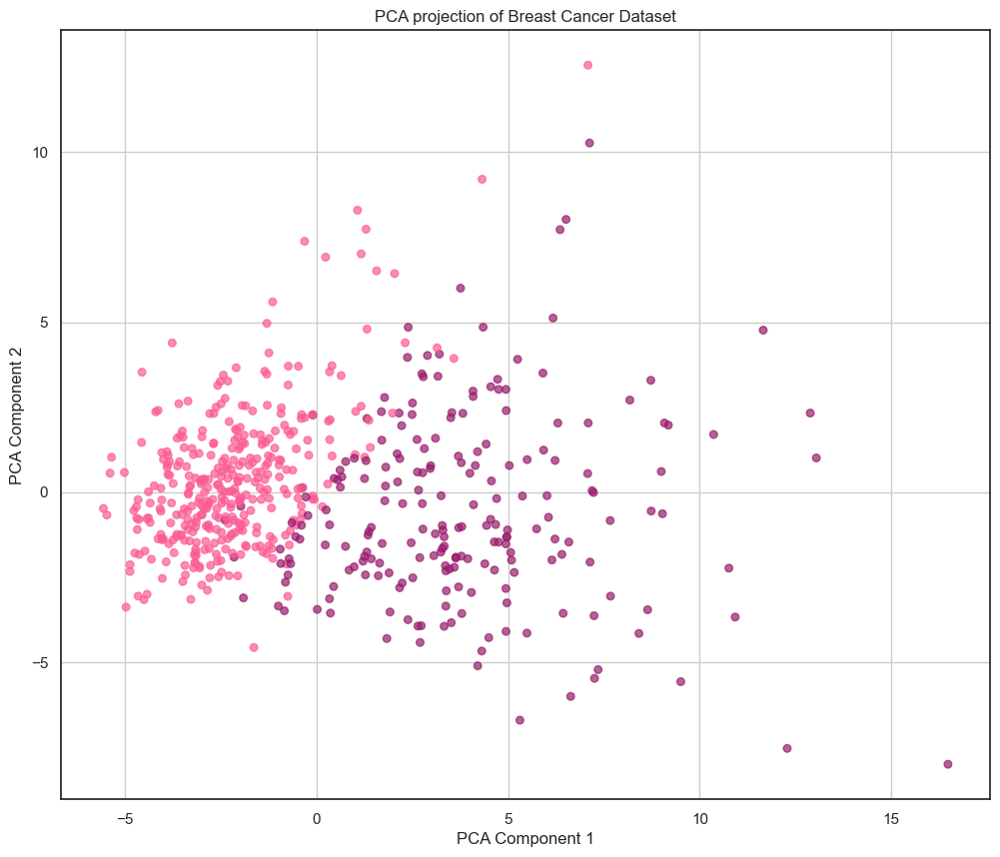

In [14]:
custom_colors = {0: "#fc5c94", 1: "#981c6c"}

X_scaled = StandardScaler().fit_transform(X)
pca = PCA(n_components=2)
X_pca_scaled = pca.fit_transform(X_scaled)

plt.figure(figsize=(12, 10))
plt.scatter(X_pca_scaled[:, 0], X_pca_scaled[:, 1], c=y.map(custom_colors), alpha=0.7, s=30)
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('PCA projection of Breast Cancer Dataset')
plt.grid(True)
plt.show()


In [51]:
target_pca = pd.DataFrame(df['diagnosis'])
data_pca = df.drop('diagnosis', axis=1)

#To make a PCA, normalize data is essential
X_pca = data_pca.values
X_std = StandardScaler().fit_transform(X_pca)

pca = PCA(svd_solver='full')
pca_std = pca.fit(X_std, target_pca).transform(X_std)

pca_std = pd.DataFrame(pca_std)
pca_std = pca_std.merge(target_pca, left_index = True, right_index = True, how = 'left')

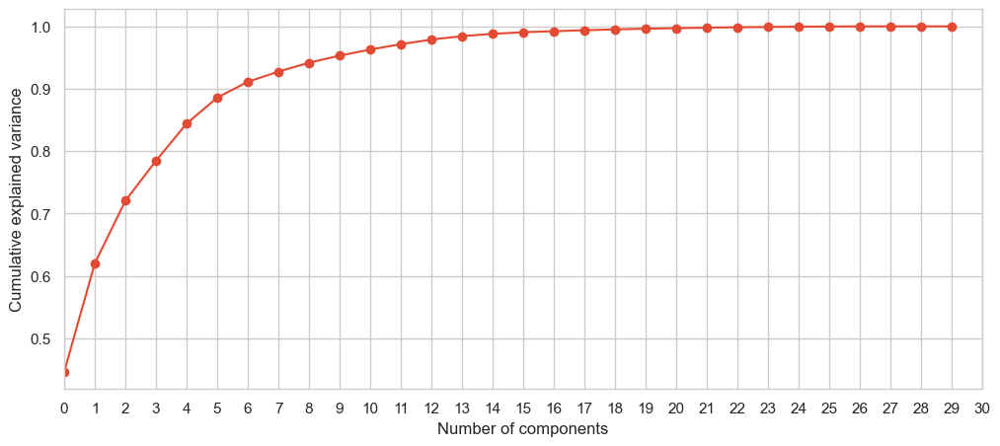

In [52]:
plt.figure(figsize=(12, 5))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlim(0, 30)  # Set lower and upper limits for the x-axis
plt.xticks(np.arange(0, 31, 1))  # Set custom ticks with a step size of 1
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.show()


In [53]:
var_pca = pd.DataFrame(pca.explained_variance_ratio_)
labels = []
for i in range(1,31):
    labels.append('Col_'+str(i))
trace = go.Pie(labels = labels, values = var_pca[0].values, opacity = 0.8,
               textfont=dict(size=15))
layout = dict(title =  'PCA : components and explained variance')
fig = dict(data = [trace], layout=layout)
py.iplot(fig)

<a id='tsne'></a>
## t-SNE (t-distributed Stochastic Neighbor Embedding)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 569 samples in 0.001s...
[t-SNE] Computed neighbors for 569 samples in 0.022s...
[t-SNE] Computed conditional probabilities for sample 569 / 569
[t-SNE] Mean sigma: 1.430424
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.001617
[t-SNE] KL divergence after 500 iterations: 0.944839


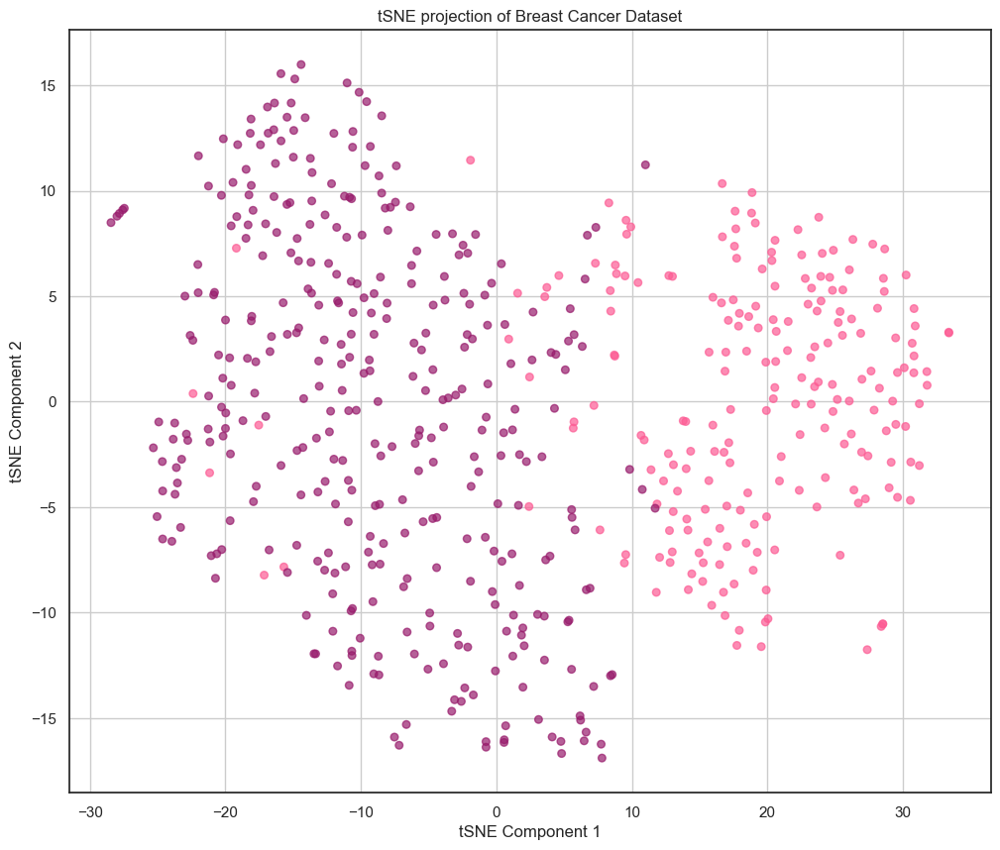

In [22]:
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Assuming X is your feature matrix and df is your DataFrame containing the 'diagnosis' column

# Standardize the features
X_scaled = StandardScaler().fit_transform(X)

# Perform t-SNE
tSNE = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=500)
tSNE_results = tSNE.fit_transform(X_scaled)

# PLOTTING
plt.figure(figsize=(12, 10))
# Define custom colors
custom_colors = {'M': "#fc5c94", 'B': "#981c6c"}
plt.scatter(tSNE_results[:, 0], tSNE_results[:, 1], c=df['diagnosis'].map(custom_colors), alpha=0.7, s=30)
plt.xlabel('tSNE Component 1')
plt.ylabel('tSNE Component 2')
plt.title('tSNE projection of Breast Cancer Dataset')
plt.grid(True)
plt.show()


In [55]:
pca.explained_variance_ratio_

array([4.46380247e-01, 1.73921362e-01, 1.00118724e-01, 6.42590674e-02,
       5.94288560e-02, 4.15840738e-02, 2.54594333e-02, 1.62203187e-02,
       1.43275858e-02, 1.12520663e-02, 9.80155599e-03, 8.63553161e-03,
       7.40950929e-03, 5.45161332e-03, 3.70277887e-03, 2.54032992e-03,
       1.71613424e-03, 1.51916114e-03, 1.30269213e-03, 1.11344975e-03,
       9.03492816e-04, 7.68698470e-04, 6.88546885e-04, 4.77091393e-04,
       4.07666896e-04, 2.85008652e-04, 2.48131245e-04, 5.26691004e-05,
       2.05729397e-05, 3.63227443e-06])

<a id='ml'></a>
## Machine Learning Classification

<a id='sp'></a>
> ### Building Feature Set<br>
>>  Preparing data for model building and checking. 30 percent of data is kept aside for validation purposes. We will also be performing scaling of data using sklearn's MinMaxScaler.

In [18]:
X = df.drop('diagnosis',axis=1).values
y = df['diagnosis'].values

sc = StandardScaler()
X = sc.fit_transform(X)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

<a id='svm'></a>
> ### Support Vector Machine(SVM)

In [19]:
def plot_confusion_metrix(y_test,model_test):
    cm = metrics.confusion_matrix(y_test, model_test)
    plt.figure(1)
    plt.clf()
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Wistia)
    classNames = ['Benign','Malignant']
    plt.title('Confusion Matrix')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    tick_marks = np.arange(len(classNames))
    plt.xticks(tick_marks, classNames)
    plt.yticks(tick_marks, classNames)
    s = [['TN','FP'], ['FN', 'TP']]
    for i in range(2):
        for j in range(2):
            plt.text(j,i, str(s[i][j])+" = "+str(cm[i][j]))
    plt.show()
    
def report_performance(model):

    model_test = model.predict(X_test)

    print("\n\nConfusion Matrix:")
    print("{0}".format(metrics.confusion_matrix(y_test, model_test)))
    print("\n\nClassification Report: ")
    print(metrics.classification_report(y_test, model_test))
    #cm = metrics.confusion_matrix(y_test, model_test)
    plot_confusion_metrix(y_test, model_test)

def roc_curves(model):
    predictions_test = model.predict(X_test)
    fpr, tpr, _ = roc_curve(predictions_test,y_test)
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=1, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic')
    plt.legend(loc="lower right")
    plt.show()
    
def accuracy(model):
    pred = model.predict(X_test)
    accu = metrics.accuracy_score(y_test,pred)
    print("\nAccuracy Of the Model: ",accu,"\n\n")

On linear kernel:


Confusion Matrix:
[[109   1]
 [  7  29]]


Classification Report: 
              precision    recall  f1-score   support

           0       0.94      0.99      0.96       110
           1       0.97      0.81      0.88        36

    accuracy                           0.95       146
   macro avg       0.95      0.90      0.92       146
weighted avg       0.95      0.95      0.94       146



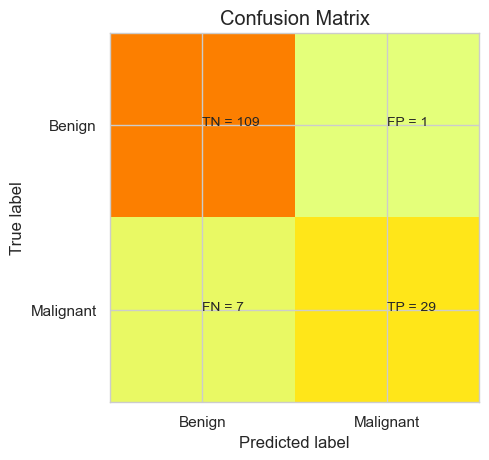

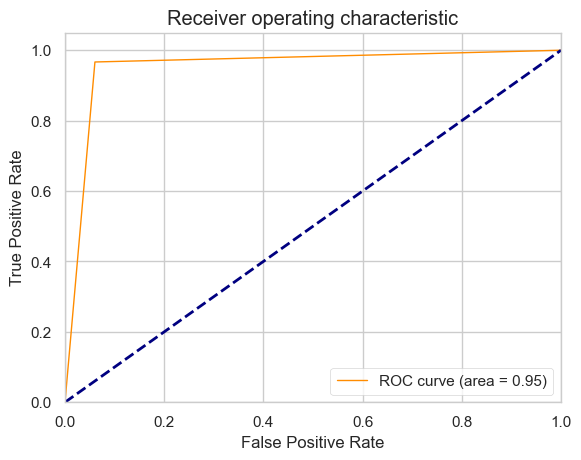


Accuracy Of the Model:  0.9452054794520548 


On rbf kernel:


Confusion Matrix:
[[110   0]
 [  7  29]]


Classification Report: 
              precision    recall  f1-score   support

           0       0.94      1.00      0.97       110
           1       1.00      0.81      0.89        36

    accuracy                           0.95       146
   macro avg       0.97      0.90      0.93       146
weighted avg       0.95      0.95      0.95       146



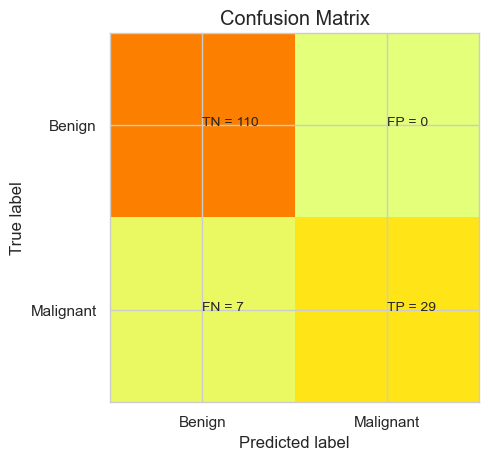

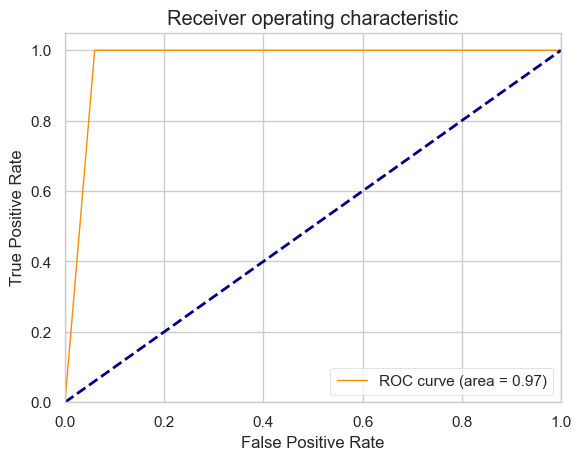


Accuracy Of the Model:  0.952054794520548 




In [58]:
for i in ['linear','rbf']:
    clf = SVC(kernel=i)
    clf.fit(X_train,y_train)
    print("On "+ i + " kernel:" )
    report_performance(clf)
    roc_curves(clf)
    accuracy(clf)

<a id='ks'></a>
> #### Kernel Selection Using Learning Curve

In [ ]:
cv = ShuffleSplit(n_splits=10, test_size=0.2, random_state=0)
estimator = SVC(kernel='linear')
vp.plot_learning_curve(estimator, 'Kernel = Linear', X, y, cv=cv)
estimator = SVC(kernel='rbf')
vp.plot_learning_curve(estimator, 'kernel = RBF', X, y, cv=cv)

> ### Bias-Variance Tradeoff
> - High bias is a sign of underfitting(model is not complex enough to pick up the nuances in the data) and high variance is a sign of overfitting(model is by-hearting the data and cannot generalize well). Think about which model(depth 1 or 10) aligns with which part of the tradeoff
> - **On RBF Kernel: High Variance**
> - There is a substantial gap between the training and testing scores.
-  The training Accuracy is close to 1 while the testing accuracy is comparitively lower (closer to 0.7). This indicates overfitting of data.
- This indicates the model is fitting the dataset well but not generalizing well hence the model is suffering from high variance(Overfitting).

<a id='srp'></a>
> #### Selection of Regularization parameter(C)
> - C is a regularization parameter that controls the trade off between the achieving a low training error and a low testing error that is the ability to generalize your classifier to unseen data. Consider the objective function of a linear SVM 

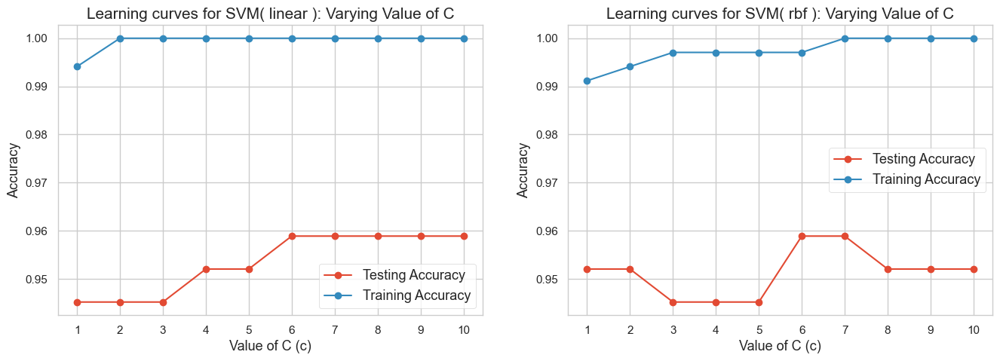

In [60]:
fig = plt.figure(figsize=(16,5))
def plotlc(kernel=None,k=0):
    plt.subplot(k)
    cp = np.arange(1, 11)
    train_accuracy = np.empty(len(cp))
    test_accuracy = np.empty(len(cp))
    for i, c in enumerate(cp):
        clf = SVC(C=c,kernel = kernel)
        clf.fit(X_train, y_train)
        train_accuracy[i] = clf.score(X_train, y_train)
        test_accuracy[i] = clf.score(X_test, y_test)

        #plt.figure(figsize=(10,5))
    plt.title('Learning curves for SVM( '+ kernel+' ): Varying Value of C', size=15)
    plt.plot(cp, test_accuracy, marker ='o', label = 'Testing Accuracy')
    plt.plot(cp, train_accuracy, marker ='o', label = 'Training Accuracy')
    plt.legend(prop={'size':13})
    plt.xlabel('Value of C (c)', size=13)
    plt.ylabel('Accuracy', size=13)
    plt.xticks(cp);
#plt.show()

plotlc('linear',121)
plotlc('rbf',122)

> #### Optimal Model



Confusion Matrix:
[[110   0]
 [  7  29]]


Classification Report: 
              precision    recall  f1-score   support

           0       0.94      1.00      0.97       110
           1       1.00      0.81      0.89        36

    accuracy                           0.95       146
   macro avg       0.97      0.90      0.93       146
weighted avg       0.95      0.95      0.95       146



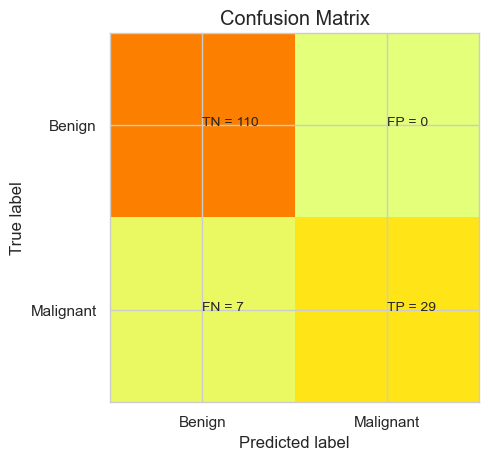

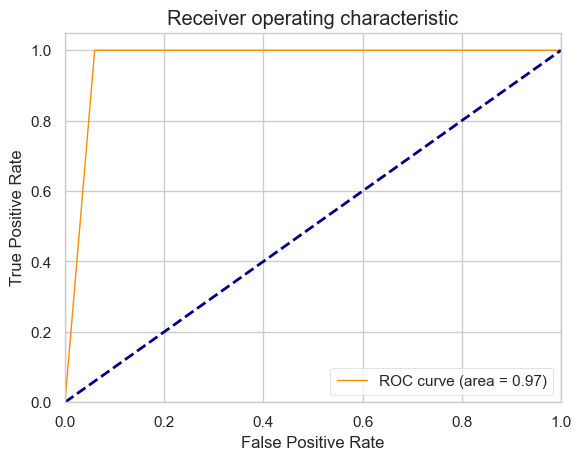


Accuracy Of the Model:  0.952054794520548 




In [61]:
clf = SVC(kernel='rbf',C=1)
clf.fit(X_train,y_train)
report_performance(clf)
roc_curves(clf)
accuracy(clf)

In [62]:

# Logistic Regression


logreg= LogisticRegression()

logreg.fit(X_train, y_train)

y_pred_logreg = logreg.predict(X_test)


# Gradient Boosting Classifier


GB = GradientBoostingClassifier()

GB.fit(X_train, y_train)

y_pred_GB = GB.predict(X_test)



# Random Forest Classifier

rf = RandomForestClassifier()

rf.fit(X_train, y_train)

y_pred_rf = rf.predict(X_test)


# Decision Tree Classifier

dt = DecisionTreeClassifier()

dt.fit(X_train, y_train)

y_pred_dt = dt.predict(X_test)


# KNeighbors Classifier


knn = KNeighborsClassifier(n_neighbors=5)

knn.fit(X_train, y_train)

y_pred_knn = knn.predict(X_test)


# XGB Classifier

XGB = XGBClassifier() 

XGB.fit(X_train, y_train)

y_pred_XGB = XGB.predict(X_test)



# Support Vector classifier

svc = SVC(probability=True)

svc.fit(X_train,y_train)

y_pred_svc = svc.predict(X_test)

In [63]:
X_train.shape, y_train.shape,X_test.shape, y_test.shape

((340, 30), (340,), (146, 30), (146,))

In [80]:
models = []

Z = [SVC() , DecisionTreeClassifier() , LogisticRegression() , KNeighborsClassifier() ,XGBClassifier(),
    RandomForestClassifier() , GradientBoostingClassifier()]


X = ["SVC" , "DecisionTreeClassifier" , "LogisticRegression" , "KNeighborsClassifier" ,
    "RandomForestClassifier" , "GradientBoostingClassifier", "XGB"]

for i in range(0,len(Z)):
    model = Z[i]
    model.fit( X_train , y_train )
    pred = model.predict(X_test)
    models.append(accuracy_score(pred , y_test))   

<a id='sum'></a>
## Summary of models performance



In [81]:
d = { "Accuracy" : models , "Algorithm" : X }
data_frame = pd.DataFrame(d)
data_frame

,Accuracy,Algorithm
0,0.952055,SVC
1,0.890411,DecisionTreeClassifier
2,0.958904,LogisticRegression
3,0.938356,KNeighborsClassifier
4,0.931507,RandomForestClassifier
5,0.938356,GradientBoostingClassifier
6,0.945205,XGB


In [17]:
d = { "Accuracy" : models , "Algorithm" : X }
data_frame = pd.DataFrame(d)
data_frame

NameError: name 'models' is not defined

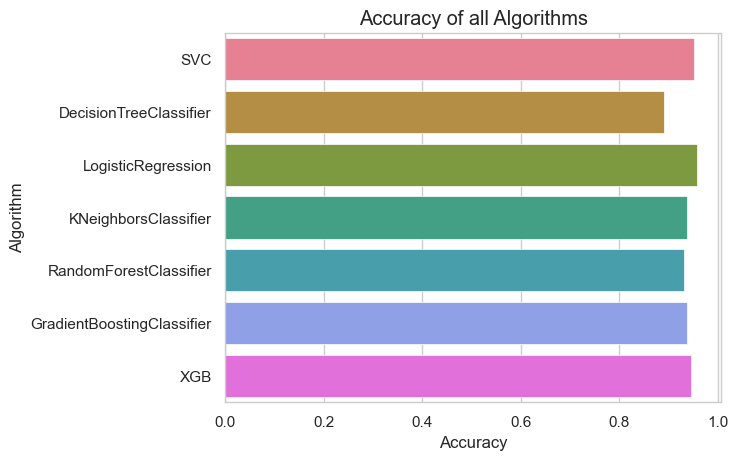

In [83]:

# Create the bar plot
sns.barplot(x='Accuracy', y='Algorithm', data=data_frame, palette="husl")

# Set the title
plt.title('Accuracy of all Algorithms')

# Show the plot
plt.show()

In [84]:
# Print the best algorithm
best_algorithm = data_frame.loc[data_frame['Accuracy'].idxmax(), 'Algorithm']
print("Best Algorithm:", best_algorithm)

Best Algorithm: LogisticRegression


In [73]:
cm = np.array(confusion_matrix(y_test, y_pred_logreg, labels=[1,0]))

confusion_mat= pd.DataFrame(cm, index = ['cancer', 'healthy'],
                           columns =['predicted_cancer','predicted_healthy'])

confusion_mat

,predicted_cancer,predicted_healthy
cancer,30,6
healthy,0,110


<Axes: >

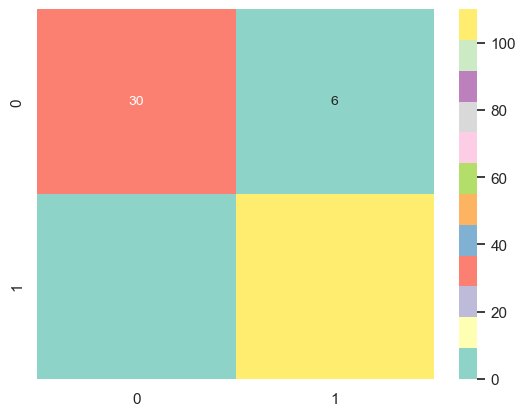

In [85]:
sns.heatmap(cm,annot=True,fmt='g',cmap='Set3')

- As we can see from the table above:

   - **True Positive(TP)** : Values that the model predicted as yes(Healthy), and is actually yes(Healthy).
   - **True Negative(TN)** : Values that the model predicted as not(Cancer), and is actually no(Cancer).
   - **False Positive(FP)**: Values that the model predicted as yes(Healthy), but actually no(Cancer).
   - **False Negative(FN)**: Values that the model predicted as no (Cancer), but actually yes(Healthy).


For this dataset, whenever the model is predicting something as yes, it indicates Absence of cancer cells (Healthy) and for cases when the model predicting no; it indicates existence of cancer cells(Cancer).


In [75]:
print(accuracy_score(y_test, y_pred_logreg)) #(TP + TN)/total

0.958904109589041


- **Precision** is the ratio of correctly predicted positive observations to the total predicted positive observations.

In [86]:
print(precision_score(y_test, y_pred_logreg))

1.0


- **Recall** also called Sensitivity, is the ratio of positive instances that are correctly detected by the classifier to the all observations in actual class

In [89]:
print(recall_score(y_test, y_pred_logreg))

0.8333333333333334


### Classification Report

In [92]:
print(classification_report(y_test, y_pred_logreg))

              precision    recall  f1-score   support

           0       0.95      1.00      0.97       110
           1       1.00      0.83      0.91        36

    accuracy                           0.96       146
   macro avg       0.97      0.92      0.94       146
weighted avg       0.96      0.96      0.96       146



<a id='cmrc'></a>
## Confusion Metrix and ROC Curve

0.9825757575757577


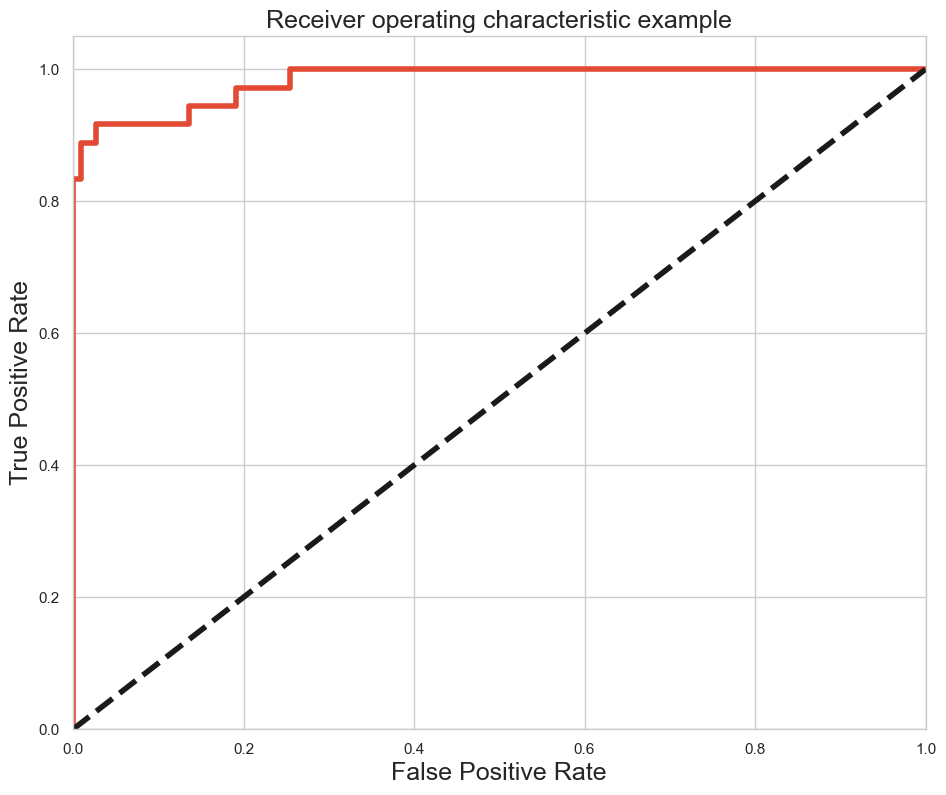

In [94]:
y_score = svc.decision_function(X_test)

FPR, TPR, _ = roc_curve(y_test, y_score)
ROC_AUC = auc(FPR, TPR)
print (ROC_AUC)

plt.figure(figsize =[11,9])
plt.plot(FPR, TPR, label= 'ROC curve(area = %0.2f)'%ROC_AUC, linewidth= 4)
plt.plot([0,1],[0,1], 'k--', linewidth = 4)
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate', fontsize = 18)
plt.ylabel('True Positive Rate', fontsize = 18)
plt.title('Receiver operating characteristic example', fontsize= 18)
plt.show()

- The ROC curve shows the trade-off between sensitivity (or TPR) and specificity (1 – FPR). As we notice the **svc** Classifier give a curve closer to the top-left corner so it indicate a better performance. 

## Area Under Curve
Area Under Curve is a common way to compare classifiers. A perfect classifier will have ROC AUC equal to 1


In [95]:
roc_auc_score(y_test, y_score)

0.9825757575757577